# European Weather Data Exploratory Data Analysis

## Import Necessary Libraries

In [1]:
## Import necessary libraries
from urllib.parse import quote

## Import necessary API
import sys
sys.path.append('../../../../')
from api.v2.util.data_load import data_load
from api.v2.util.get_tag_name import show_column
from api.v2.eda.Data_Info import Data_Info
from api.v2.eda.Statistical_test import adf_test, kpss_test, pp_test, ljung_box_test, arch_test, vif_test
from api.v2.eda.Visualize_EDA import Visualize_EDA

## Set European Weather Data Base Parameter

In [2]:
# Set European Weather Data Base Parameter

# Set MachBase Neo URL address
URL = 'http://127.0.0.1:5654'
# Set Tag Table Name
table = 'eu_weather'
# Set TimeFormat - > 'default' or '2006-01-02 15:04:05.000000'(Divided down to the nanosecond)
timeformat = 'default'
# Set resample Option -> D(day), H(hour), T(minute), S(second)
resample_freq = None

## Check European Weather Data Info

In [3]:
# Print European Weather DataInfo
Data_Info(URL, table, timeformat, resample_freq)

Tag List: ['AT_radiation_diffuse_horizontal', 'AT_radiation_direct_horizontal', 'AT_temperature', 'BE_radiation_diffuse_horizontal', 'BE_radiation_direct_horizontal', 'BE_temperature', 'BG_radiation_diffuse_horizontal', 'BG_radiation_direct_horizontal', 'BG_temperature', 'CH_radiation_diffuse_horizontal', 'CH_radiation_direct_horizontal', 'CH_temperature', 'CZ_radiation_diffuse_horizontal', 'CZ_radiation_direct_horizontal', 'CZ_temperature', 'DE_radiation_diffuse_horizontal', 'DE_radiation_direct_horizontal', 'DE_temperature', 'DK_radiation_diffuse_horizontal', 'DK_radiation_direct_horizontal', 'DK_temperature', 'EE_radiation_diffuse_horizontal', 'EE_radiation_direct_horizontal', 'EE_temperature', 'ES_radiation_diffuse_horizontal', 'ES_radiation_direct_horizontal', 'ES_temperature', 'FI_radiation_diffuse_horizontal', 'FI_radiation_direct_horizontal', 'FI_temperature', 'FR_radiation_diffuse_horizontal', 'FR_radiation_direct_horizontal', 'FR_temperature', 'GB_radiation_diffuse_horizontal

## Set European Weather Data Extra Parmeter
* Set based on the information confirmed in the previous step

In [4]:
# Set the desired tag names
tags = show_column(URL, table)
# Wrap each item in the list with single quotes and separate with commas
tags_ = ",".join(f"'{tag}'" for tag in tags)
# Set Tag Name
name = quote(tags_, safe=":/")
# Set Start time
start_time = '1980-01-01 00:00:00'
# Set End time 
end_time = '2019-12-31 23:00:00'
# Set TimeFormat - > 'default' or quote('2006-01-02 15:04:05.000000')(Divided down to the nanosecond)
timeformat = 'default'

In [5]:
# European Weather Data Load
df = data_load(URL, table, name, start_time, end_time, timeformat, resample_freq)

In [6]:
df

NAME,AT_radiation_diffuse_horizontal,AT_radiation_direct_horizontal,AT_temperature,BE_radiation_diffuse_horizontal,BE_radiation_direct_horizontal,BE_temperature,BG_radiation_diffuse_horizontal,BG_radiation_direct_horizontal,BG_temperature,CH_radiation_diffuse_horizontal,...,RO_temperature,SE_radiation_diffuse_horizontal,SE_radiation_direct_horizontal,SE_temperature,SI_radiation_diffuse_horizontal,SI_radiation_direct_horizontal,SI_temperature,SK_radiation_diffuse_horizontal,SK_radiation_direct_horizontal,SK_temperature
TIME,,,,,,,,,,,,,,,,,,,,,
1980-01-01 09:00:00,0.0000,0.0000,-3.640,0.0000,0.0000,-0.720,0.0000,0.0000,4.664,0.0000,...,-0.031,0.0000,0.0000,-3.945,0.0000,0.0000,-3.055,0.0000,0.0000,-4.648
1980-01-01 10:00:00,0.0000,0.0000,-3.803,0.0000,0.0000,-1.165,0.0000,0.0000,4.052,0.0000,...,0.311,0.0000,0.0000,-4.053,0.0000,0.0000,-3.272,0.0000,0.0000,-4.554
1980-01-01 11:00:00,0.0000,0.0000,-3.969,0.0000,0.0000,-1.434,0.0000,0.0000,3.581,0.0000,...,0.568,0.0000,0.0000,-4.129,0.0000,0.0000,-3.639,0.0000,0.0000,-4.455
1980-01-01 12:00:00,0.0000,0.0000,-4.076,0.0000,0.0000,-1.843,0.0000,0.0000,3.197,0.0000,...,0.610,0.0000,0.0000,-4.139,0.0000,0.0000,-4.202,0.0000,0.0000,-4.421
1980-01-01 13:00:00,0.0000,0.0000,-4.248,0.0000,0.0000,-2.094,0.0000,0.0000,2.750,0.0000,...,0.462,0.0000,0.0000,-4.239,0.0000,0.0000,-4.732,0.0000,0.0000,-4.449
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-31 19:00:00,63.4252,253.9464,4.719,101.2012,11.8643,3.024,48.9860,387.1383,2.049,61.9466,...,2.588,52.7934,48.8897,3.007,101.8680,199.2700,4.738,87.8641,202.9779,1.234
2019-12-31 20:00:00,69.7829,240.9767,5.219,117.7681,16.7410,3.879,49.4098,346.8399,2.810,76.4446,...,3.143,52.7326,48.5031,3.111,85.4326,237.9989,5.701,121.6014,107.4629,2.202
2019-12-31 21:00:00,79.9103,168.3377,5.060,115.7838,19.0342,4.702,49.1537,254.1799,2.959,87.4708,...,3.023,43.4777,25.8938,2.923,69.6235,222.6852,5.964,109.8506,32.5041,2.418


## Check Visualize_EDA

Start Visualize All Method
Removed NaN Columns: set()


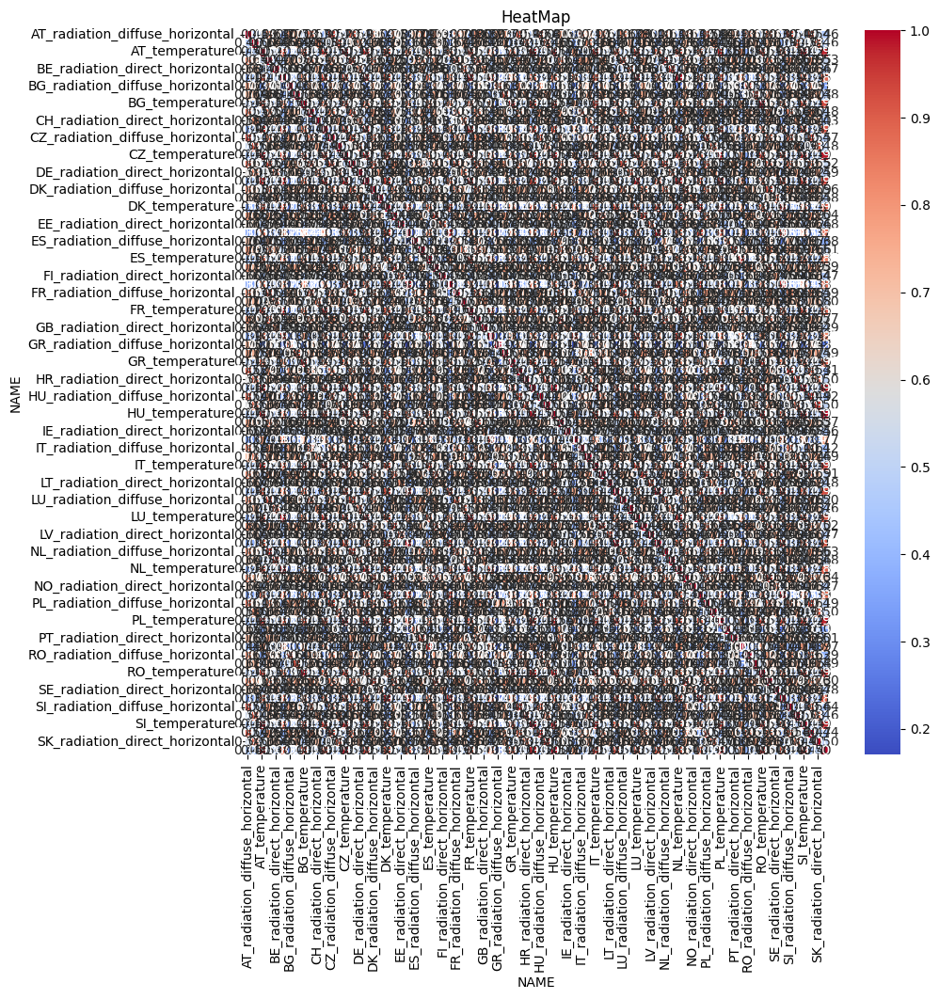

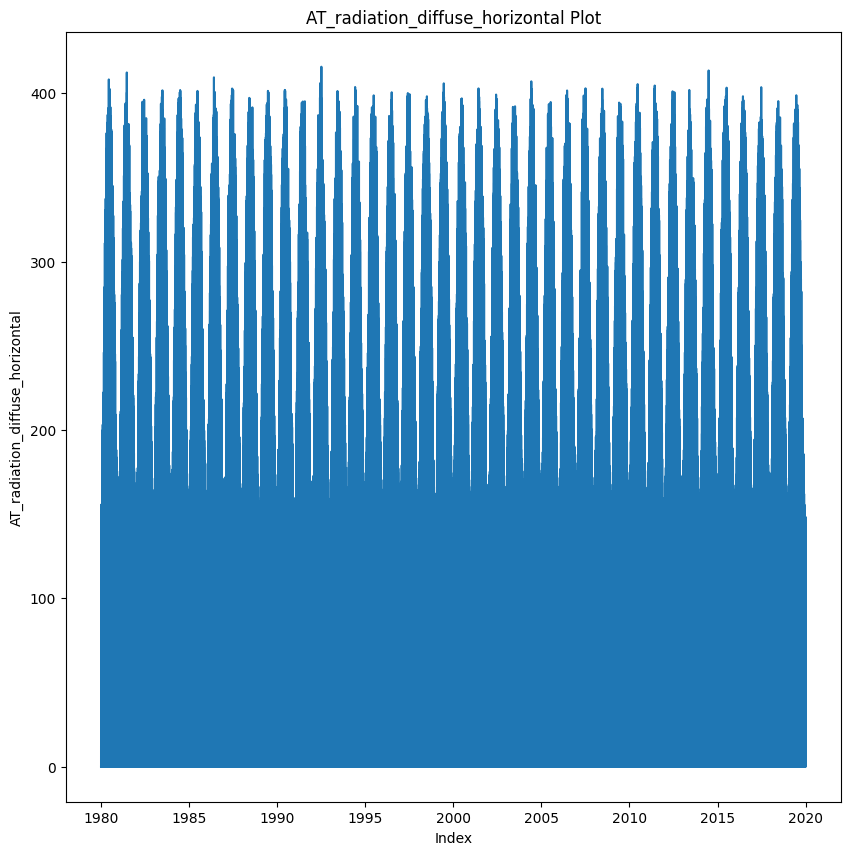

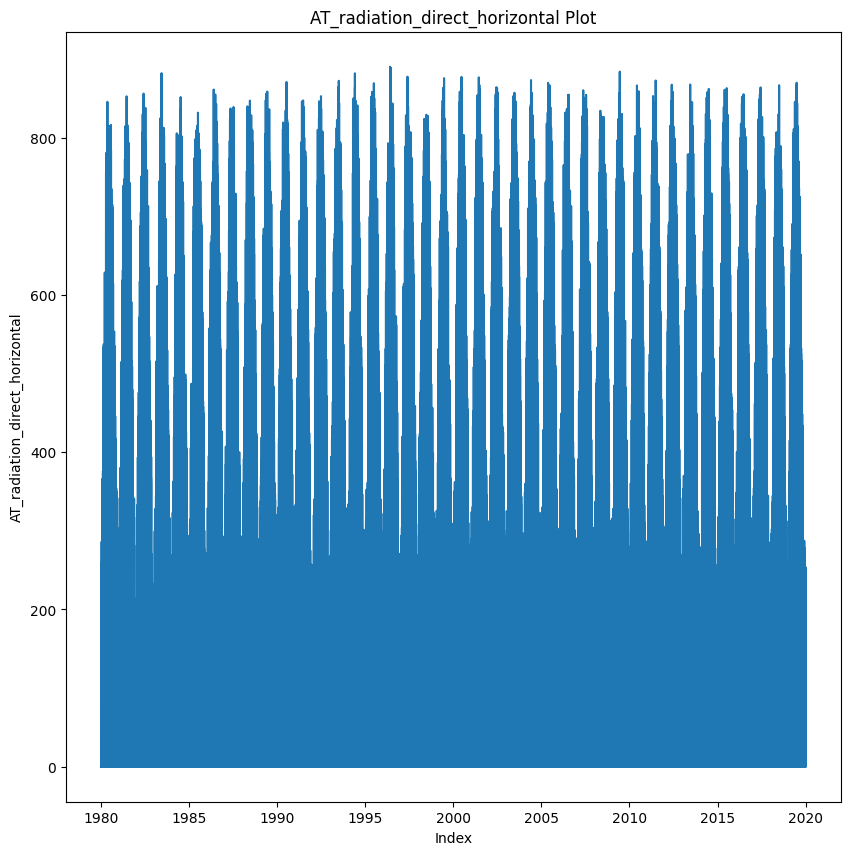

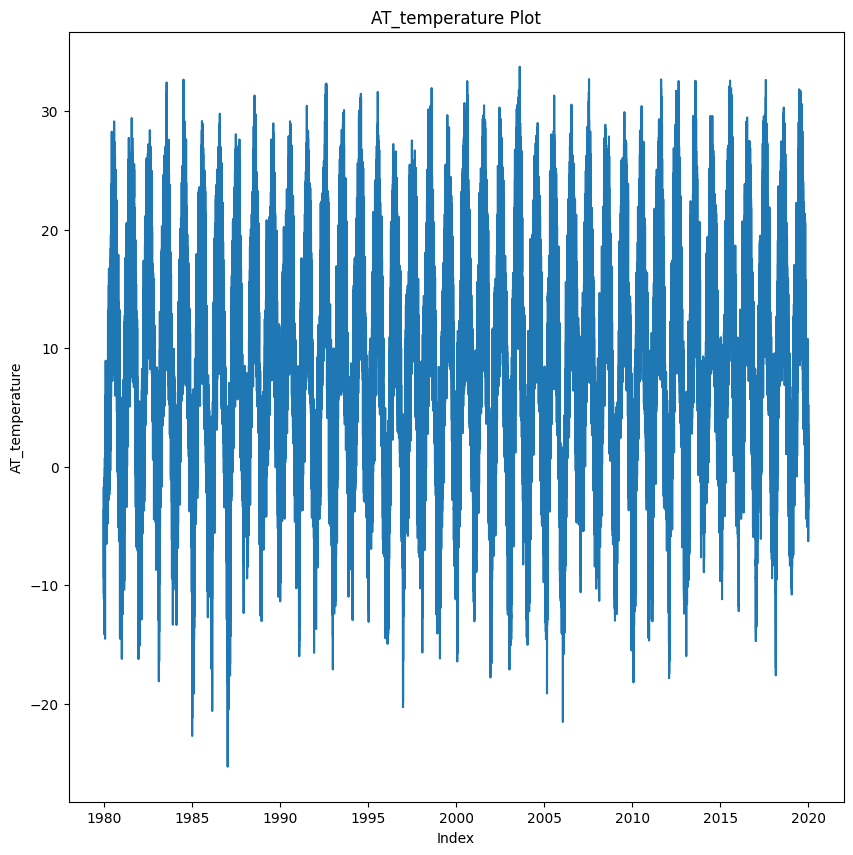

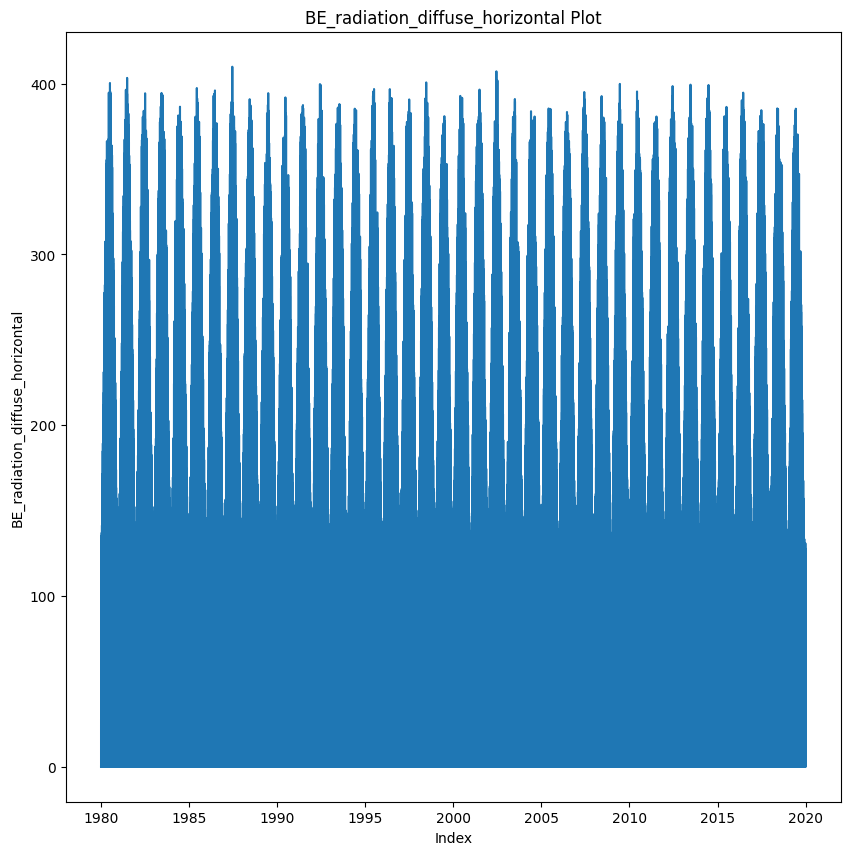

...

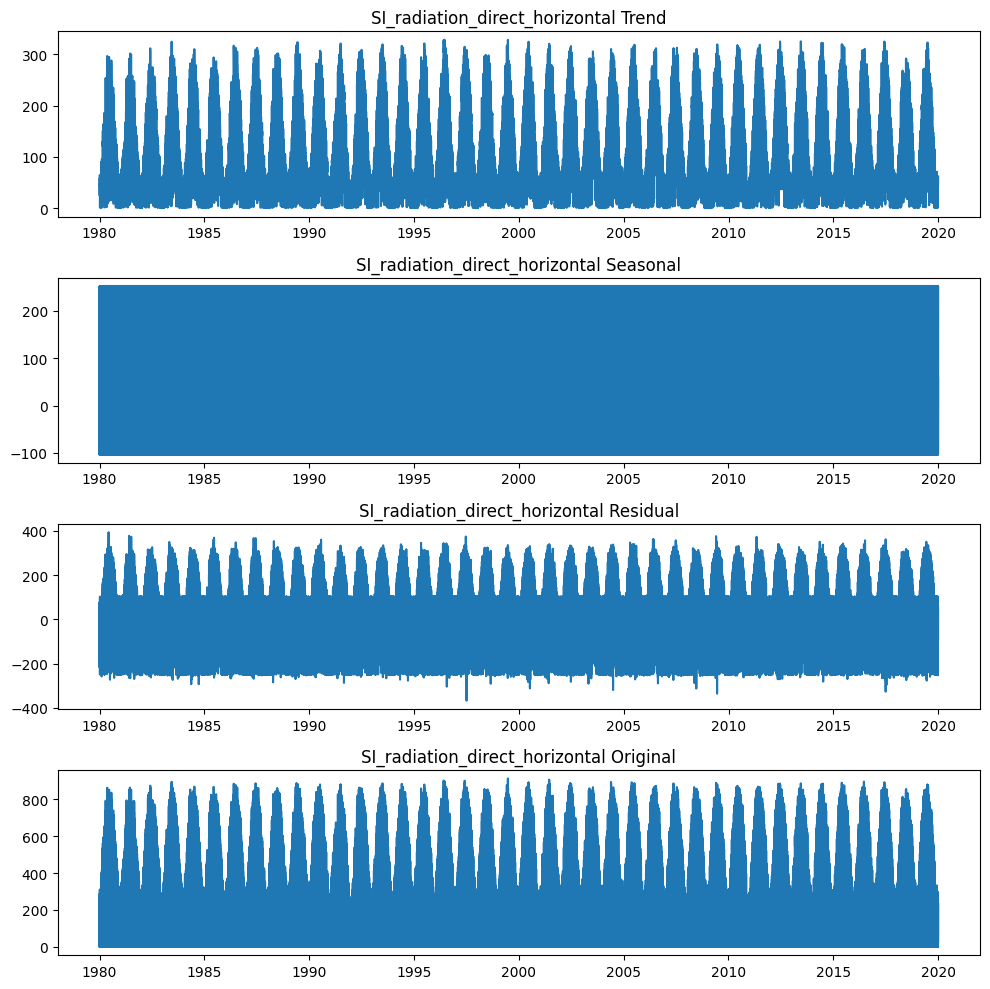

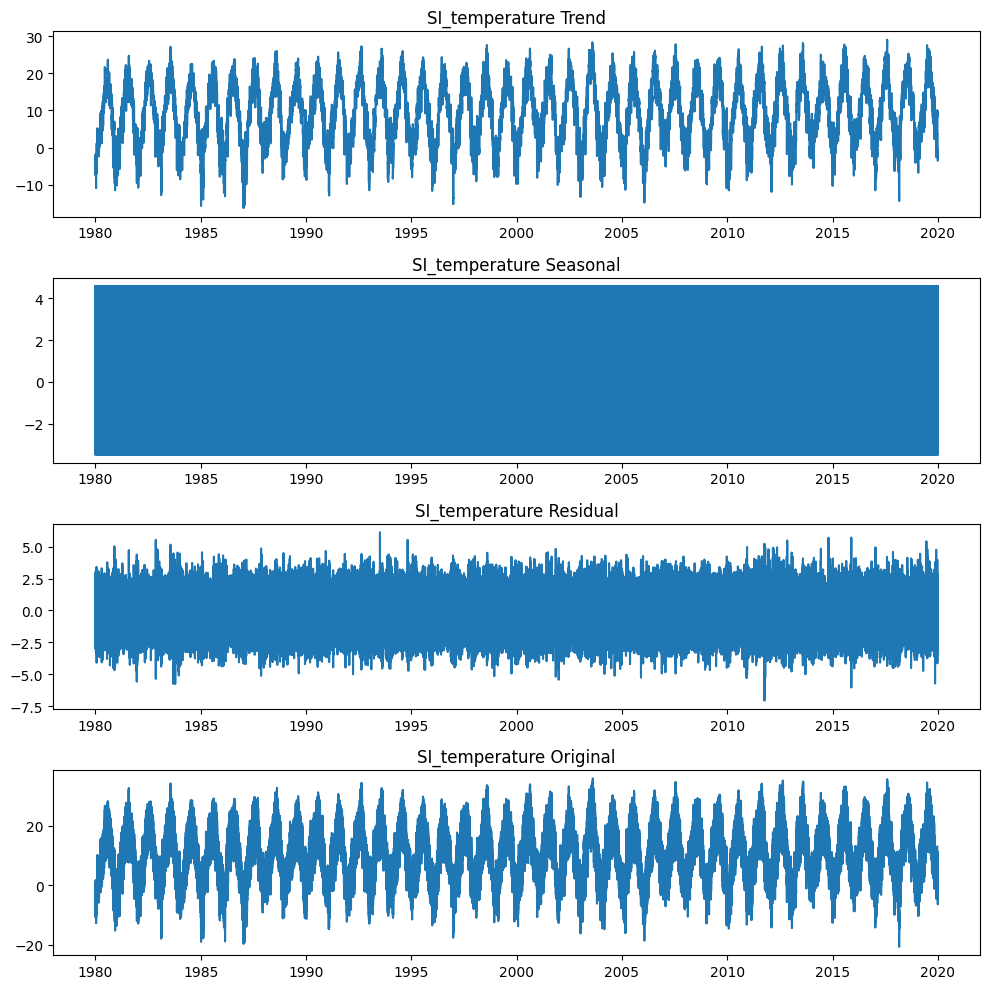

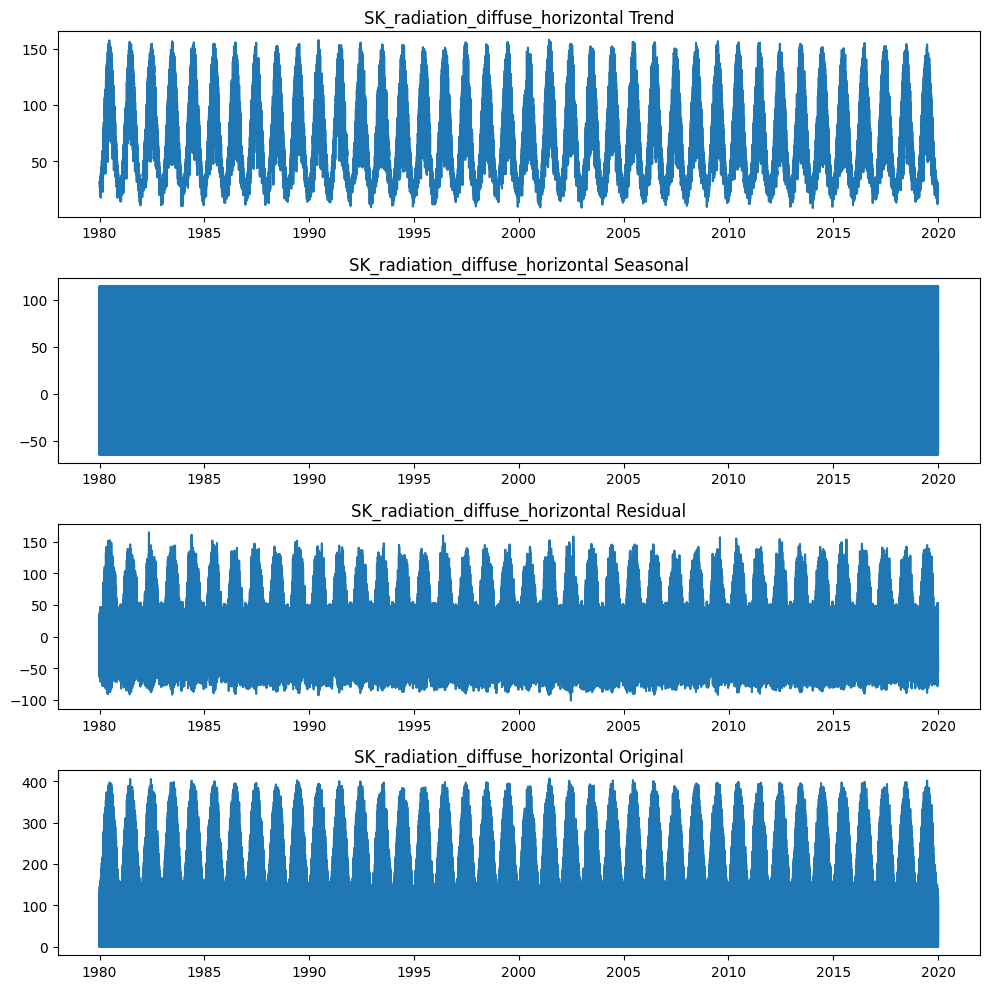

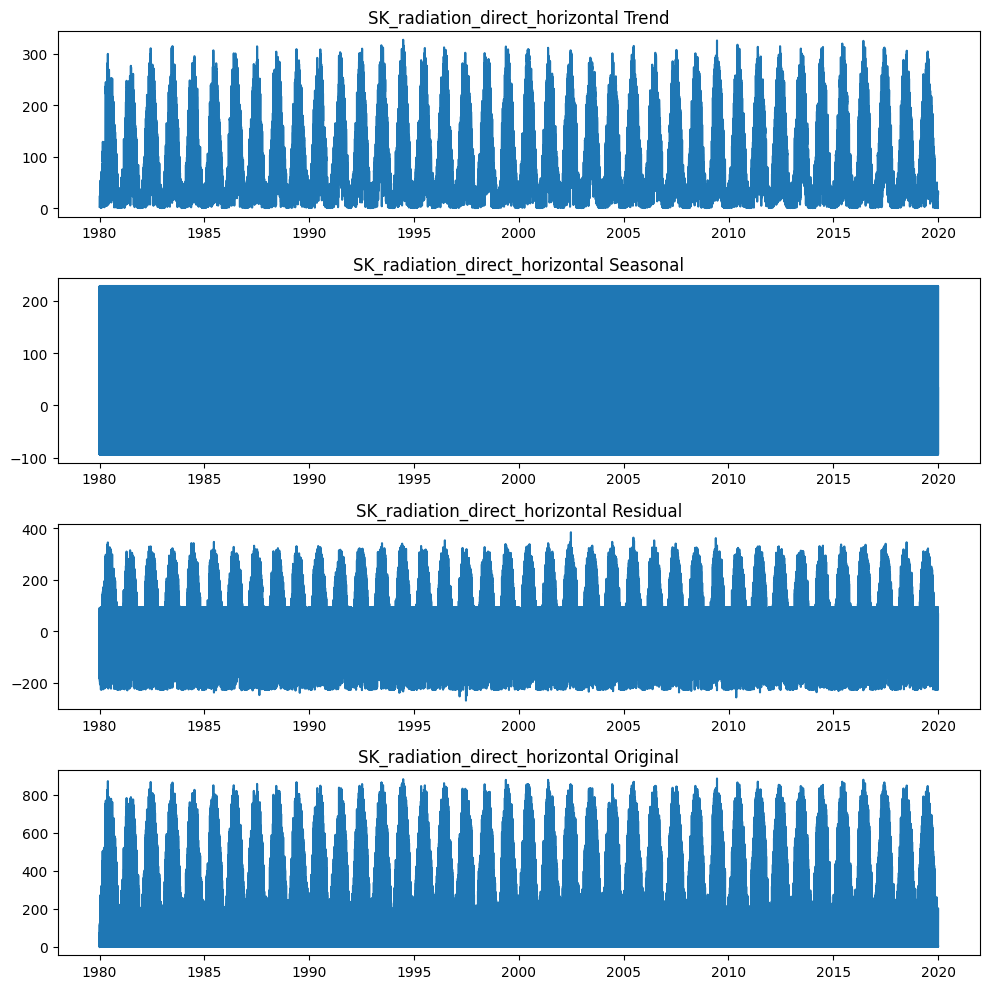

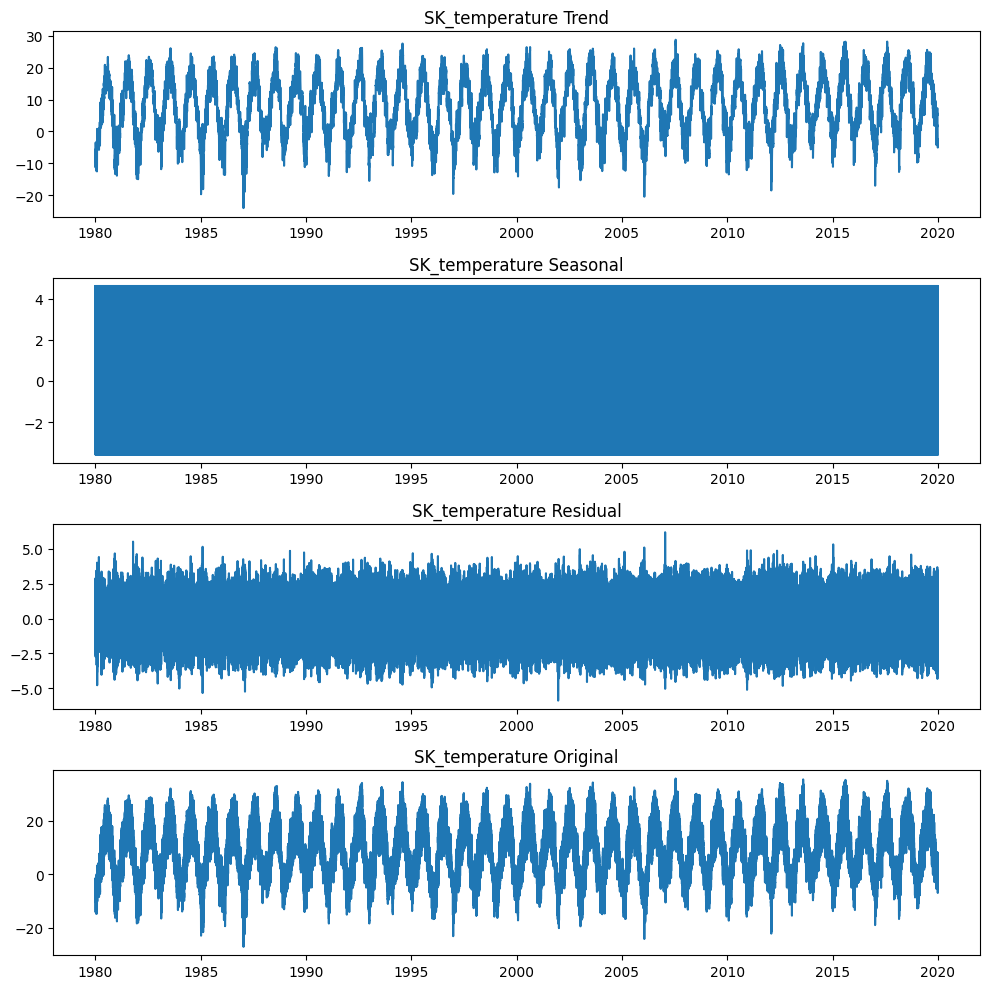

Save Finish


In [14]:
# Adjust period based on data for Decomposition
period = 24
# Plot width 
x_size = 10
# Plot height
y_size = 10
# Set option
# 1.HeatMap, 2.plot, 3.Decomposition, 4.All 
option = 4

# Set Start Function
Visualize_EDA(df, period, x_size, y_size, option)

## Check Statistical_Test

In [ ]:
# Check ADF Test
adf_test(df)


adf_test for column: AT_radiation_diffuse_horizontal
ADF Statistic: -5.610037619813059
p-value: 1.2093596388199947e-06
Critical Values: {'1%': -3.4310066595695945, '5%': -2.861830204343065, '10%': -2.5669244706354584}
The series is stationary
------------------------------------------------------------------------------------------------------------------

adf_test for column: AT_radiation_direct_horizontal
ADF Statistic: -9.064272466209998
p-value: 4.476426922309761e-15
Critical Values: {'1%': -3.431006000830514, '5%': -2.8618299132518468, '10%': -2.566924315687191}
The series is stationary
------------------------------------------------------------------------------------------------------------------

adf_test for column: AT_temperature
ADF Statistic: -2.893642236026134
p-value: 0.04609232980950809
Critical Values: {'1%': -3.4310066595695945, '5%': -2.861830204343065, '10%': -2.5669244706354584}
The series is stationary
-------------------------------------------------------------

In [ ]:
# Check KPSS Test
kpss_test(df)


kpss_test for column: AT_radiation_diffuse_horizontal
KPSS Statistic: 5.976329702702771
p-value: 0.01
Critical Values: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
The series is not stationary
------------------------------------------------------------------------------------------------------------------

kpss_test for column: AT_radiation_direct_horizontal
KPSS Statistic: 2.9118064258724727
p-value: 0.01
Critical Values: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
The series is not stationary
------------------------------------------------------------------------------------------------------------------

kpss_test for column: AT_temperature
KPSS Statistic: 3.708289319574717
p-value: 0.01
Critical Values: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
The series is not stationary
------------------------------------------------------------------------------------------------------------------

kpss_test for column: BE_radiation_diffuse_horizontal
KP

In [ ]:
# Check PP Test
pp_test(df)


pp_test for column: AT_radiation_diffuse_horizontal

Phillips-Perron Test for column: AT_radiation_diffuse_horizontal
Test Statistic: -14.757159236779259
p-value: 2.4338243904976724e-27
The series is stationary
------------------------------------------------------------------------------------------------------------------

pp_test for column: AT_radiation_direct_horizontal

Phillips-Perron Test for column: AT_radiation_direct_horizontal
Test Statistic: -14.542684262517021
p-value: 5.115419936715732e-27
The series is stationary
------------------------------------------------------------------------------------------------------------------

pp_test for column: AT_temperature

Phillips-Perron Test for column: AT_temperature
Test Statistic: -5.393221668565662
p-value: 3.5000282041519054e-06
The series is stationary
------------------------------------------------------------------------------------------------------------------

pp_test for column: BE_radiation_diffuse_horizontal

Phi

In [ ]:
# Check ljung box Test
ljung_box_test(df, lags=10)


Ljung-Box Test for column: AT_radiation_diffuse_horizontal
p-value: 0.0
There is autocorrelation
------------------------------------------------------------------------------------------------------------------

Ljung-Box Test for column: AT_radiation_direct_horizontal
p-value: 0.0
There is autocorrelation
------------------------------------------------------------------------------------------------------------------

Ljung-Box Test for column: AT_temperature
p-value: 0.0
There is autocorrelation
------------------------------------------------------------------------------------------------------------------

Ljung-Box Test for column: BE_radiation_diffuse_horizontal
p-value: 0.0
There is autocorrelation
------------------------------------------------------------------------------------------------------------------

Ljung-Box Test for column: BE_radiation_direct_horizontal
p-value: 0.0
There is autocorrelation
---------------------------------------------------------------------

In [ ]:
# Check Arch Test
arch_test(df)


arch_test for column: AT_radiation_diffuse_horizontal
ARCH Model Results:

Omega (Intercept): 9.89e+01
Alpha[1] (ARCH Term): 1.0000

Model Evaluation:
Log-Likelihood: -50404.00
AIC (Akaike Information Criterion): 100814.00
BIC (Bayesian Information Criterion): 100835.63

Interpretation:
Omega value is low, indicating a low level of volatility in the model.
Alpha[1] is high, suggesting that past variances have a strong effect on current volatility.
------------------------------------------------------------------------------------------------------------------

arch_test for column: AT_radiation_direct_horizontal
ARCH Model Results:

Omega (Intercept): 3.19e+01
Alpha[1] (ARCH Term): 1.0000

Model Evaluation:
Log-Likelihood: -46576.13
AIC (Akaike Information Criterion): 93158.27
BIC (Bayesian Information Criterion): 93179.90

Interpretation:
Omega value is low, indicating a low level of volatility in the model.
Alpha[1] is high, suggesting that past variances have a strong effect on cu

In [ ]:
# Check VIF Test
vif_test(df)

Variable: const, VIF: 62.74, Interpretation: High multicollinearity
Variable: AT_radiation_diffuse_horizontal, VIF: 49.41, Interpretation: High multicollinearity
Variable: AT_radiation_direct_horizontal, VIF: 29.36, Interpretation: High multicollinearity
Variable: AT_temperature, VIF: 158.76, Interpretation: High multicollinearity
Variable: BE_radiation_diffuse_horizontal, VIF: 34.63, Interpretation: High multicollinearity
Variable: BE_radiation_direct_horizontal, VIF: 23.43, Interpretation: High multicollinearity
Variable: BE_temperature, VIF: 128.37, Interpretation: High multicollinearity
Variable: BG_radiation_diffuse_horizontal, VIF: 36.85, Interpretation: High multicollinearity
Variable: BG_radiation_direct_horizontal, VIF: 37.05, Interpretation: High multicollinearity
Variable: BG_temperature, VIF: 121.18, Interpretation: High multicollinearity
Variable: CH_radiation_diffuse_horizontal, VIF: 28.73, Interpretation: High multicollinearity
Variable: CH_radiation_direct_horizontal, V